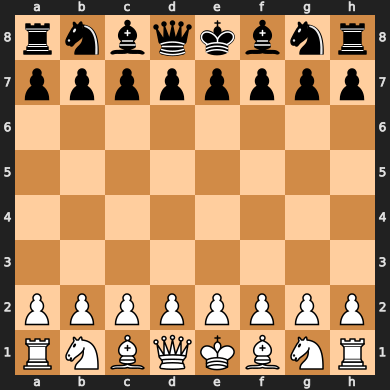

In [27]:
#pip install chess
import chess
import math
import time

board1 = chess.Board()

import chess.svg


board1

In [28]:
print(board1)

r n b q k b n r
p p p p p p p p
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
P P P P P P P P
R N B Q K B N R


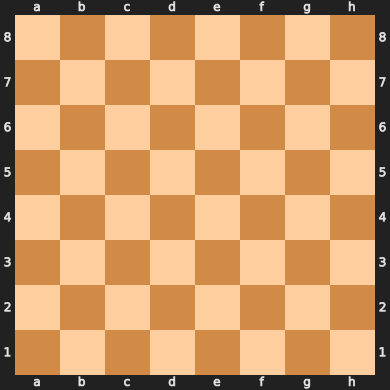

In [29]:
chess.Board.clear(board1)
board1

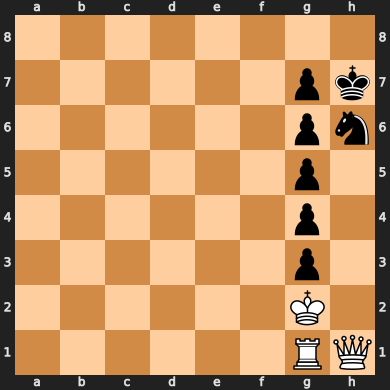

In [30]:
chess.Board.clear(board1)
chess.Board.set_piece_at(board1, chess.H7, chess.Piece.from_symbol('k'))
chess.Board.set_piece_at(board1, chess.G2, chess.Piece.from_symbol('K'))

chess.Board.set_piece_at(board1, chess.H1, chess.Piece.from_symbol('Q'))
chess.Board.set_piece_at(board1, chess.G1, chess.Piece.from_symbol('R'))



chess.Board.set_piece_at(board1, chess.H6, chess.Piece.from_symbol('n'))
chess.Board.set_piece_at(board1, chess.G7, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board1, chess.G6, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board1, chess.G5, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board1, chess.G4, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board1, chess.G3, chess.Piece.from_symbol('p'))

board1

In [31]:
import time
from IPython.display import display, HTML, clear_output

In [32]:
def who(player):
    return "White" if player == chess.WHITE else "Black"

In [33]:
def display_board(board, use_svg):
    if use_svg:
        return board._repr_svg_()
    else:
        return "<pre>" + str(board) + "</pre>"
    

In [34]:
def play_game(player1, player2, board, visual="svg", pause=0.5):
    """
    playerN1, player2: functions that takes board, return uci move
    visual: "simple" | "svg" | None
    """
    use_svg = (visual == "svg")
    #board = chess.Board()
    try:
        while not board.is_game_over(claim_draw=True):
            if board.turn == chess.WHITE:
                uci = player1(board)
            else:
                uci = player2(board)
                
            name = who(board.turn)
            board.push_uci(uci)
            board_stop = display_board(board, use_svg)
            html = "<b>Move %s %s, Play '%s':</b><br/>%s" % (
                       len(board.move_stack), name, uci, board_stop)
            if visual is not None:
                if visual == "svg":
                    clear_output(wait=True)
                display(HTML(html))
                if visual == "svg":
                    time.sleep(pause)
    except KeyboardInterrupt:
        msg = "Game interrupted!"
        return (None, msg, board)
    result = None
    if board.is_checkmate():
        msg = "checkmate: " + who(not board.turn) + " wins!"
        result = not board.turn
    elif board.is_stalemate():
        msg = "draw: stalemate"
    elif board.is_fivefold_repetition():
        msg = "draw: 5-fold repetition"
    elif board.is_insufficient_material():
        msg = "draw: insufficient material"
    elif board.can_claim_draw():
        msg = "draw: claim"
    if visual is not None:
        print(msg)
    return (result, msg, board)

In [35]:
import random

def random_player(board):
    move = random.choice(list(board.legal_moves))
    return move.uci()

In [36]:
def basic_heuristic_player(board):
    moves = list(board.legal_moves)
    for move in moves:
        newboard = board.copy()
        # go through board and return a score
        move.score = heuristic_staticAnalysis(newboard, move, board.turn)
    moves.sort(key=lambda move: move.score, reverse=True) # sort on score
    return moves[0].uci()

def heuristic_staticAnalysis(board, move, my_color):
    score = 0
    ## Check some things about this move:
    # score += 10 if board.is_capture(move) else 0
    # To actually make the move:
    board.push(move)
    # Now check some other things:
    for (piece, value) in [(chess.PAWN, 1), 
                           (chess.BISHOP, 4), 
                           (chess.KING, 0), 
                           (chess.QUEEN, 10), 
                           (chess.KNIGHT, 5),
                           (chess.ROOK, 3)]:
        score += len(board.pieces(piece, my_color)) * value
        score -= len(board.pieces(piece, not my_color)) * value
        # can also check things about the pieces position here
    return score

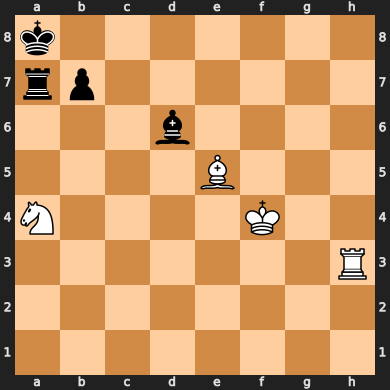

In [37]:
board2 = chess.Board()
chess.Board.clear(board2)
chess.Board.set_piece_at(board2, chess.F4, chess.Piece.from_symbol('K'))
chess.Board.set_piece_at(board2, chess.A8, chess.Piece.from_symbol('k'))

chess.Board.set_piece_at(board2, chess.A4, chess.Piece.from_symbol('N'))
chess.Board.set_piece_at(board2, chess.E5, chess.Piece.from_symbol('B'))
chess.Board.set_piece_at(board2, chess.H3, chess.Piece.from_symbol('R'))



chess.Board.set_piece_at(board2, chess.A7, chess.Piece.from_symbol('r'))
chess.Board.set_piece_at(board2, chess.B7, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board2, chess.D6, chess.Piece.from_symbol('b'))


board2

In [46]:
#comp move uses minimax algorithm (chess one)
def compMove(board):
    moves = list(board.legal_moves)
    bestScore = -math.inf
    bestMove = 0
    for move in moves:
        newboard = board.copy()
        newboard.push(move)
        score = minimax(newboard, 0, False)
        newboard = board.copy()

        if (score > bestScore):
            bestScore = score
            bestMove = move
            
    return bestMove.uci()

#defines minimax algorithm
def minimax(board, depth, isMaximizing):
    maxDepth = 3
    moves = list(board.legal_moves)

    if chess.Board.is_checkmate(board) == True:
        return 1
    #elif (checkWhichMarkWon(player)):
        #return -1
    elif chess.Board.is_stalemate == True:
        return 0
    
    #else:
        #print('no terminal state yet')

    if (isMaximizing):
        bestScore = -math.inf
        for move in moves:
            newboard = board.copy()
            newboard.push(move)
            
            if depth < maxDepth:
                score = minimax(newboard, depth + 1, False)
            else:
                #print('max depth of',maxDepth,'reached')
                return -math.inf #not found check mate
            
            newboard = board.copy() #remove move

            if (score > bestScore):
                bestScore = score

        return bestScore
        

    else:
        bestScore = math.inf
        for move in moves:
            newboard = board.copy()
            newboard.push(move)
            
            if depth < maxDepth:
                score = minimax(newboard, depth + 1, True)
            else:
                #print('max depth of',maxDepth,'reached')
                return math.inf #not found check mate
            
            newboard = board.copy() #remove move
          
            if (score < bestScore):
                bestScore = score
        return bestScore


In [95]:
#PRINt TREE VERSION

#comp move uses minimax algorithm (chess one)
def compMovePrinted(board):
    moves = list(board.legal_moves)
    bestScore = -math.inf
    bestMove = 0
    
    #keep track of number of first tree nodes
    comp_count = 1
    
    for move in moves:
        newboard = board.copy()
        newboard.push(move)
        
        #to visualise tree 1st move
        print('comp node number:', comp_count)
        print('a first comp tree node:')
        print(newboard)
        comp_count +=1
        #print('current best score:', bestScore)
        
        
        score = minimaxPrinted(newboard, 0, False)
        newboard = board.copy()

        if (score > bestScore):
            bestScore = score
            bestMove = move
            
    return bestMove.uci()

#defines minimax algorithm
def minimaxPrinted(board, depth, isMaximizing):
    maxDepth = 3
    moves = list(board.legal_moves)

    if chess.Board.is_checkmate(board) == True:
        print('CHECKMATE FOUND')
        return 1
    #elif (checkWhichMarkWon(player)):
        #return -1
    elif chess.Board.is_stalemate == True:
        print('STALEMATE FOUND')
        return 0
    
    #else:
        #print('no terminal state yet')

    if (isMaximizing):
        bestScore = -math.inf
        for move in moves:
            newboard = board.copy()
            newboard.push(move)
            
            #to visualise move tree
            print('maximising below comp node', 'depth:', depth, ', trial board move:')
            print(newboard)
        
            
            if depth < maxDepth:
                print('not reached max depth so call minimising')
                score = minimaxPrinted(newboard, depth + 1, False)
            else:
                print('max depth of',maxDepth,'reached so try new comp move node')
                return -math.inf #not found check mate
            
            newboard = board.copy() #remove move
            
            

            if (score > bestScore):
                bestScore = score

        return bestScore
        

    else:
        bestScore = math.inf
        for move in moves:
            newboard = board.copy()
            newboard.push(move)
            
            #to visualise move tree
            print('minimising below comp node','depth:', depth, ', trial board move:')
            print(newboard)
            
            if depth < maxDepth:
                print('not reached max depth so call maximising')
                score = minimaxPrinted(newboard, depth + 1, True)
            else:
                print('max depth of',maxDepth,'reached so try new comp move node')
                return math.inf #not found check mate
            
            newboard = board.copy() #remove move
          
            if (score < bestScore):
                bestScore = score
        return bestScore


In [96]:
board3 = chess.Board()
chess.Board.clear(board3)
chess.Board.set_piece_at(board3, chess.F4, chess.Piece.from_symbol('K'))
chess.Board.set_piece_at(board3, chess.A8, chess.Piece.from_symbol('k'))



chess.Board.set_piece_at(board3, chess.H3, chess.Piece.from_symbol('R'))
chess.Board.set_piece_at(board3, chess.G3, chess.Piece.from_symbol('B'))
chess.Board.set_piece_at(board3, chess.G7, chess.Piece.from_symbol('R'))



chess.Board.set_piece_at(board3, chess.A6, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board3, chess.B7, chess.Piece.from_symbol('p'))


print('original board:')
print(board3)


play_game(compMovePrinted, random_player, board3, visual='simple', pause=1)

original board:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
comp node number: 1
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
a first comp tree node:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
minimising below comp node depth: 0 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R .
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . R
p k . . . . . 

maximising below comp node depth: 3 trial board move:
. k . . . R . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . R . . .
p . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . R
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p p . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . R
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . R
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p R . . . . .
p k . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
. . . 

. k . . . . . .
. . . . . R . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
p . . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. p . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . R
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . R
p p . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
. . . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
. . . . . . . .
. . . . . . . .
p . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . B
. . . . . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . . . .
. p . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . R
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . R
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . R . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . R . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . R . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . R . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . . . . R . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . R . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . R . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . R . .
p k . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
p k . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . R . .
p p . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. p . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . R . .
. . . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . R . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . R . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . R . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. p . . . . . .
. . . 

k . . . . R . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K 

minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . K .
. . . . R . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . R K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . R . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . R K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p p . 

maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . R . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . R . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. k . . R . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . R . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . R . . .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . R . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . R . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
. . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . R . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. R . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . R
. . . . R . . .
p p . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . R . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p p . . R . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . R . . .
. . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . R K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . K .
. . . . R . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . R K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . R . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . . . . . .
p p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . .
. . . . . . . .
. p . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . R . . .
p . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . . .
. . . R . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . .
p . . . . . . .
. . . R . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . R . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. p . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
p . . 

. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . R . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . R . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . R . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . R . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . R . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . R . . . .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . K .
. . . R . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . R . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . R . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . . .
. . . R . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . R
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . R . . . .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. . . . . . . .
p p . . . . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. . . . . . . .
p p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
. . . . . . . .
p p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
p . . . . . . .
. . . . K . . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . k R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . R . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . R . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . R . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . R . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . R . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
k p . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . K .
. . R . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . R . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . . K .
. . R . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . R . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p R . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p R . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . R . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . R . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . R . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . R . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . R . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
p . . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. R . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p R . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
. . . . . . . 

. k R . . . . .
. p . . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
k p . . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p R . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . R . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . R . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . R . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . R . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p . . 

minimising below comp node depth: 0 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . .
. . . . . . . .
p . . . . . . K
. . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. . . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. . . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. . . . . . . .
p k . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. . . . . . . .
p k . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

k . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . K .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
p R . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . K .
p R . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. R . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k R . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . R
. R . . . . . .
. . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

k . . . . . . .
. p . . . . . .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. R . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. R k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . R .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
p . R . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . R . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . p 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
. . p . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . R . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . . R
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . R
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . R . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . R . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . R . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . . . .
. p . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . . . .
. p . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . 

. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. R . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. R k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. R . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k R . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

. k . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . 

. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
. . R . . . . .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . R . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p R . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
k . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . R . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . R . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . R . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
. k . . . . . .
p p . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . R
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . R
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . B . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . K . .
. . . . . . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . K .
. p . . . . . .
. . . . . . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . K . .
. . . . . . R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
. p . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

k . . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . R
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . R
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . R
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R R
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . R
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . R
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . R . .
p p . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . K R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . K R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . K .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . K .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . K .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . K .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . B . . . R .
. p . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k B . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p B . . . R .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k B . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . B . . . R .
. . . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . R .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . R .
. p . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . K .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . K .
. p . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. p . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . K .
. . . . . B . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p B . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. B . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p B . . . R .
p k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p B . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p B . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . R .
. . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . K . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . K . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . K . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . K . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . .
. . . . . . . .
. . . . . K . .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
. . . . . . . .
. . . . . K . .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . R . .
p . . 

k . . . . . . .
. . B . . . R .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k B . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . B . . . R .
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . B . . . R .
p . . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k B . . . R .
p . . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . R . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . R . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . K . . . .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . K . . . .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . K . . . .
. p . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . K . . . .
. p . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . K . R .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . K . R .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . B . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . B . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . B . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . B . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
k R . . . . . .
. . . . . . . .
. p . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
R . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
R . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
R k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . 

k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 0 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . K . .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . K . .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . K . .
p . . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . . .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . .
. p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . R . . .
p . . . . . . .
. p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. . . . . . . .
p . . . . . . .
. p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . K . .
p p . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . K . .
p p . . . . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . K . .
. . . . . . . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . K . .
. . . . . . . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . K . . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . K . . .
. p . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. p . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . K . . .
. . . . . B . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . R .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

. . . . . . . .
k . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . K
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . K
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . K
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . K B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . K B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k B . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . B . . . R .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . B . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . B . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p R . . . . .
p k . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . B . . . R .
p p . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . B . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p B . . . R .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p B . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . B . . . R .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . R .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 0 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
k . . . . . R .
. p . . . . . .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . . . K . . .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . K . . .
p . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . B . . . R .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k B . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p B . . . R .
. . . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k B . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . B . . . R .
. . . 

k . . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B R
. . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . R . . .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . R
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . R
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . B . . . .
. . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . B . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . B . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . B . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. R . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . B
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . B
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . B
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . B . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . B . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . B . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . B . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . B . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . .
. . . . . . . .
. p . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. . . 

k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . . . B
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . B . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . B . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . B . .
. . . . . K . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . . .
. p . . . B . .
. . . . . K 

maximising below comp node depth: 3 trial board move:
k R . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . R .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. B . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p B . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p B . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p B . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p B . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . R
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
CHECKMATE FOUND
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. p . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . B . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . B . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . B . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . B . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . 

not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . K . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . R .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . 

not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board mov

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . R . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . R . R
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . R . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . R
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R R
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . R .
p p . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . R . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . R
p . . 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R R
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
. p . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . R . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . R . R
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R R
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
. p . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
. p . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
. . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
p . . . . . . .
. . . . . . . .
. p . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
p . . . . . . .
. . . . . . . .
. p . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R R
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R R
p . . 

. k . R . . . .
. . . . . . . .
p . . . . . . R
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p R . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p R . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R R
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p R . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p R . . . . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . R
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . R
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . R
. p . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . R R
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . R
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . R . . . . .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . R . . . . .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
p . . . . . . R
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
. . . . . . . R
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
. . . . . . . R
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . R
. . . . . . . .
p . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . R
p p . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . R
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. . . . . . . R
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . R
. . . . . . . .
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
p . . . . . . R
. . . . . . . .
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . R
. . . . . K . .
. p . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. p . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . R
. p . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . R
. p . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. . . . . . . .
p . . . . . . .
. p . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . R . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . R . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . R . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . R . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . . R
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . R
p p . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

maximising below comp node depth: 3 trial board move:
. k . R . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. p . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
. p . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . R . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . R . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . R . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . R . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . . R
p . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . R
p . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

k . . . . . . .
. . . . . . . .
. . . . . . R .
p p . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . . . R
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . R
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . R R
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . K . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . R
. p . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. p . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . K . . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . R . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . R . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . R .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . R
. . . . . K 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . R . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

maximising below comp node depth: 1 trial board move:
k . . . . . . R
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
CHECKMATE FOUND
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R R
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R R
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . R
. . . . . . . .
p p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. p . . . . . .
. . . . . . . 

. k . . . . R .
. p . . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. R . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k R . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
R . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
R . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . R
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R R
p . . 

minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . R . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . R . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . R .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . R
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . R
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . R
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . 

. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node 

. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . .
. p . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . R . . . .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . R .
not reached max depth so call minimising
minimising below comp node depth: 2

. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . R . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . . R . . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p R . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . R . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . R . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . R . . . .
. . . . . . . .
. . . . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . R .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . R .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . R .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . R . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . R . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . B . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . B . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . B . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . B . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . B . R .
. . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . B . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . B . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . B . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . B . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . B . . .
p p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . R . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . R R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . R R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . B . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . R R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . K . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . K R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . K R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . K R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . . R .
p . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . B
. . . . R . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . R . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . R . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . R . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. p . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . K . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . K . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . K . .
. . . . . . . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . R R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . R R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . R R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . R R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . 

. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
R . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . R R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . R R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . R B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . R B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . R . .
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . R . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . R
. p . . . . R .
. . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . R . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . R .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . R .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . R .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
k . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . . B
. . . . . . R .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
R . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . B . .
. . . . . . R .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . R .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . B . .
. . . . . . R .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . R .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p p . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

. . k . . . . .
. p . . . . R .
p . . . . . . .
. . B . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . B . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . B . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . B . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . B . . . . .
. . . . . K . .
. . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . R . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . R . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
R . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
R . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
R . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
R . . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K R .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . B . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . B . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . B . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p B . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. p . . . . . .
. . . . . . R R
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B R .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . B R .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . B R .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . R . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . R . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . k . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . R R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . R R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . R R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. p k . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . R . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . R . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . R . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . R . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. B . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. B . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . R . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . R . . .
p . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . R .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . R .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . R .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . R .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . R . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . R . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. R . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
p p . . . . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. B . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. B . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. B . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. B . . . K . .
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . 

. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K R .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. R . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . B . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . B . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . B . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . B . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . R . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . R . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. R . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
. . . . . . . .
p p . . . . K .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . . K .
. p . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. p . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K . .
R . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
. . . 

comp node number: 1
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
a first comp tree node:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
minimising below comp node depth: 0 trial board move:
. . . . . . R .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node dept

minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R .
. p . . R . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . R . . .
p . . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. R . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. R . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R .
. p . . . . . .
p k . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . R .
p . k 

minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
k p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . R .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
. . . . . . R .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . R . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . R . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . R . . .
. k . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . . .
p . k . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p . k 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . R . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . R . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
p . k 

minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
k p . . . . R .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . R
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . R . .
k p . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . . R
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . R
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . R . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . 

maximising below comp node depth: 1 trial board move:
. . . . R . . .
. p . . . . . .
p k . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p k . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
. k . 

. . . . . R . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . R . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . R . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . R . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . R . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . R . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . R . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . R . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . R . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . k 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . R . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. R . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. R . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. R . . . . . .
p . . 

. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
p . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
p . . . . . . .
. . k . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . K . .
. . . . . . . .
. . . . . . 

. . . R . . . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . R . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
. k . 

minimising below comp node depth: 2 trial board move:
. . . R . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . R
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . R .
k . . . . . . .
. p . 

. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . R . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . R . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . R . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. . . . . . R .
p k p . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. . . . . . . .
p k p . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . . R
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . R
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . . R
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . R
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

. . R . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . R . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K 

. . . R . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . R . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
. . R . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . R . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . R . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . R . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
k p . . R . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . R . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
k p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . R . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . R . . .
p . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . R . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . R .
p . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . R . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . R . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . R . .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . R . .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

maximising below comp node depth: 1 trial board move:
. . . . . R . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. R . . . . . .
k p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . R . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . R .
k . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
k p . . . . R .
. . . . . . . .
. . . . K . . .
p . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . K . . .
p . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. R . . . . . .
k p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. R . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. R . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. R . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . R .
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . R .
p . . . . . . .
. k . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . . .
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . . .
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . R
p . . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . 

. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . 

k . . . . . . R
. . . R . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p R . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R R
p . . . . . . .
. . k . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R R
p . . . . . . .
. k . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . R . . R
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . R . . R
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R R
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R R
. k . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . R
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p p . . . . . R
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p p . 

. k . . . . . .
. . . . . . R .
R . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
R . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
p p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . R
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . R
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . R
. p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . R
. p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
p . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
. . . . . . . R
p p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . R . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
. . . R . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . R . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . R . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . R
p . . 

maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . R . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
k p . . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R R
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . R .
p p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . K . . R
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . R
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p . k . . . . .
. . . . . . . R
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . R
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . R
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . R
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . R
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . R
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . R
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
. . . . . . . R
p . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . R
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . R . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . R . . .
p p . 

. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . R . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p . . . . . R .
. . k . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . k . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p . . . . . R .
. k . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . k . . . . .
. . . . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . k . . . . .
. . . . K . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . R .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . K R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . K R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . K R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
k . . 

maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . R . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k R . . . . .
. . . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . R
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p R . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . R . . . . .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p R . . . . .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . 

maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . k . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R R
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. k . . . . . .
. p . . . . R .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. p . . . . R .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. R . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 3 trial board move:
k . . . R . . .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . R . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
p . . 

maximising below comp node depth: 1 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . R . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . R . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . R . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . R . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . . .
p . . . . . R .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . R
. . . . B . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . 

. . . . . . . .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
comp node number: 14
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
a first comp tree node:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
minimising bel

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p p . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . R . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . R . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . R . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . R . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . R .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
k . . . . . . R
. p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . R . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . R . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . 

not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
R . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 0 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . 

maximising below comp node depth: 3 trial board move:
k R . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. R . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. R . . . . . .
. . . . . . . .
k . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
R . . . . . . .
max depth of 3 reached so try new comp move node
comp node number: 15
. . . . . . R R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
a first comp tree node:
. . . . . . R R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
minimising below comp node depth: 0 trial board move:
. . . . . . R R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . R .
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp 

. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . R . . . R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . R . . . R
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . R .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p . k . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . k . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
. p . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
p . . . . . . .
. p . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R R
. k . . . . . .
p p . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . R
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . . R
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . R R
. . . . . . . .
p k . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. . . . . . . R
p k . . . . . .
. p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
. . . . . . . .
p p . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . R
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . R . . . .
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . R . . . .
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . . . . R
p . k 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. R . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . R
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . R
p . . . . . . .
. k . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . R
p . k . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
p . k . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . R
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . R . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
k . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . 

. . . . . . R .
. p . . . . . R
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . R
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . R
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . 

maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . R . .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . R . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . R . .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . R . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . R . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
p . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
p . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . R . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . R . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
k p . . . R . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . R . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . R . . . .
k p . . . R . .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p R . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p R . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p R . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p R . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . R . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . R . . .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . R . . .
p . . . . . . .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. p . . R . . .
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . R . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . R . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . R . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
. p . . . . . .
p . k . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . R . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p . . . R . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . R . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . R . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . R . . .
p . . . . . . .
. k . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . R . . .
p . . . . . . .
k . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . R . . .
p . . . . . . .
k . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . R . . .
. k . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . R . . .
. k . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 0 trial board move:
. . . . . . . R
k p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . R .
k p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . R . . .
. k . . . . . 

maximising below comp node depth: 3 trial board move:
. k . . R . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . R . . .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . R . . .
. p . . . . . .
. k . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . R . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . R . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . R . . . . .
. p . R . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . R . . . . .
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . R . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . R . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . R . . R .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . R
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . R .
. p . . . . . .
. k . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . R . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . R . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . R . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . R . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . R . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . R . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . R . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . R . . . .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . R . . . .
p k . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . R . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . R . . . .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . R . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . R . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 1 trial board move:
. . R . . . . .
. p R . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . R . . . . .
k p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p R . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p R . . . . .
p . . . . . . 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . . R
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . R
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p R . . . . .
. k . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p R . . . . .
. k . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p R . . . . .
p k . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p R . . . . R
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p R . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p R . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p R . . . . .
. . . . . . . R
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . R . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . R . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . R . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . R . . . .
. . . . . . . .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . R . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. . k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. . . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. . . . . . . .
p . k 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . k . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. . . . . . . .
p k . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. . . . . . . .
p k . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. k . . . . . .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . R . . .
. k . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
k . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
k . . . . . . .
. p . 

maximising below comp node depth: 1 trial board move:
. . . . . . R R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R R
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . R
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
p . . . . . . 

. . . . . . . R
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . R .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . .
. . . . . . R .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . . .
. . . . . . R .
p . . . . . . R
. . . . . K . .
. . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
. . . . . . R .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . R .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 2 trial board move:
. k . . . . . .
. . . . . . . .
p . . . . . R R
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. k . . . . . R
. . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . R R
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
p . . . . . R .
. p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. p . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . R .
. p . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . . .
p k . . . . . R
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p k . . . . .
p . . . . . . R
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . . .
p k . . . . . .
. R . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. R . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . .
. R . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. R . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . R . .
. k . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
k . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
k . . . . . . .
. p . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
. p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k . . . . . R .
p p . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
CHECKMATE FOUND
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . R .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . R .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

k . . . . . . R
. p . . . . . .
. . . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k . . . . . . .
. p . . . . . R
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . . .
. . . . . . . R
. . . . . . R .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
. . . . . . R .
p . . . . K . .
. . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . R .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . R .
. . . . . . . .
p . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . R .
p p . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . . .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
k . . . . . . .
p . . . . . R .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . R .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . . R .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. . . . . . R .
. p . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . R . . . .
k . . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. k . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p . . . . . . .
. p . . . . R .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . R . . . .
. . . . . . . .
p k . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. . . . . . . .
p k . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. . . . . . . .
p k . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . . .
p . . . . . . .
. . k . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p . . . . . . .
. . k . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. R . . . . . .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p . . . . . R .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . R .
. . k . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p . . . . . R .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . R .
. k . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

minimising below comp node depth: 0 trial board move:
. . . . . . . R
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1 trial board move:
. . . . . . R .
k . . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p p . . . . . .
. . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. p . . . K . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . . . . . .
. p . . . K . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . K . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . K . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
R . . . . . . .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . . R
. . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. k . . . . . .
. p . . . . . R
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . 

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. . . . . . . .
p . . . . . . .
. p . . . . . R
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. . . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. k . . . . . .
p . . . . . . .
. p . . . . . R
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. k . . . . . .
p . . . . . . .
. p . . . . . .
. . . . . K R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. . . . . . . .
p k . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. . . . . . . .
p k . . . . . .
. p . . K . . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . . . . . .
p p . . K . . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . K . . .
. . . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
p . . . . . . .
. . . . K . . .
. p . . . . R .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
p . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . R . .
. p . . . . R .
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . B .
. . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . k . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . K . .
. . k . . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . K . .
. . k . . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . K . .
. k . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . k . . . . 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . R . . .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . R . . .
. . . . . . . .
. . . . . . K .
p . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . R . . . .
. . . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . R . . . .
. k . . . . . .
p . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . K .
. . . . . B . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . . . K .
. . . . . B . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . K .
. . . . . B . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
k . . . . . . .
p . . . . . K .
. . . . . B . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . 

. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . k . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . k . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. R . . . . . .
p . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. R . . . . . .
p . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. R . . . . . .
p . . . . . . .
. . k . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
k . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . B . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
. p . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . R
. p . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k p . . . . . .
. . . . . . . .
. . . . . K . .
p . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . R
. . . . . . . .
. . . . . K . .
p . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k . . . . . . .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. B . . . . R .
. p . . . . R .
k . . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p B . . . R .
. . . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p B . . . R .
k . . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p B . . . R .
k . . . . . . .
p . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
p . . . . . . .
. . k . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
p . . . . . . .
. k . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node 

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . K . . .
. . . . . . . R
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . .
. p . . . . R .
p k . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . R . . . .
. k . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . R . . . .
. k . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p R . . . . .
p k . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . 

. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . K . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 0 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 1

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
. k . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
. k . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
k . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
k . . . . . . .
p . . . K . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . R . .
. . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3

. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
. k . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
k . . . . . K .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . R .
. p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . R
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . B .
. . . . . . . R
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . B . . . R .
. . . . . . . .
p p . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . B . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . B . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . B . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
k . . 

maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . R . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . 

. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
p . . . . . . .
k . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
k . . K . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . K . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . K . . . .
. . . . . . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . B . . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . K . . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . K . . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . K . . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R R
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R R
k . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . R . . . .
. . . . . . . .
. . . . . . . .
p . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p R . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p R . . . . .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p R . . . . .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p R . . . . .
k . . 

max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . .
k . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B R
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial b

maximising below comp node depth: 3 trial board move:
. B . . . . R .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. B . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. B . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. B . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. B . . . . R .
. p . . . . R .
p . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . R . .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . R . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . R . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . R . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . R
p . . . . . . 

. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . B . . .
. . . . . . . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . . . . R .
p k . . . . . .
. . . . . . . .
. . . . . . . B
. . . . K . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . B
. . . . K . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . B
. . . . K . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2

minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
. k . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . R
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . K . B .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R R
. p . . . . . .
. k . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . B
. . . . K . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . B
. . . . K . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . B . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . B . .
. . . . K . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . B .
. . . . . K . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . B .
. . . . K . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board mov

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . R . . .
p . . . . . . .
k . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . R . . .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p . R . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . R . . . .
p . . 

. . . . . . R .
. p . . . . R .
p . . . . B . .
. . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . B . .
. k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . B . .
. k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . B . .
k . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . B . .
k . . . . . . .
. . . . . K . .
. . . . . . 

maximising below comp node depth: 1 trial board move:
. . . . R . . .
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . R . . .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . R .
. . . . . K . B
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K R B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K R B
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . B
. . . . . . K .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . B
. . . . . . K .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . . . B
. . . . . K . .
. . . . . . . .
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . B
. . . . . K . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
. k . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . R
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . R R
. p . . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . R R
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . R
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . R R
k p . . . . . .
p . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . R B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . R B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . R B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
p . k . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . R B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . k 

not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
p . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . k . . . . .
. . . . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
. . k . . . . .
. . . . . . . .
. . . . K . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
. k . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
. k . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
k . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
k . . . . . . .
p . . . . . . R
. . . . . K . .
. . . . . . . .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial b

max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. . . . . . . .
p p . . . . . .
. . . . . K . .
. . . . . . R .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
maximising below comp node depth: 1 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . R B
. . . . . . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . . .
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . R B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board mov

. . . . . . R .
. p . . . . R .
. k . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
k . . . . . . .
p . . . . . . .
. . . . . . . .
. . . . . . K .
. . . . . . . B
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . K .
. . . . . . . B
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . R .
. . . . . . . .
. . . . . . . .
p . . . . . . .
. . . . . . 

minimising below comp node depth: 2 trial board move:
. . . . . . . .
k p . . . . R .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
p . . . . . . R
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . . . . . R
. . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . . .
p . . . . . . R
. . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R .
p . . 

maximising below comp node depth: 1 trial board move:
. . . . . . . R
. p R . . . . .
p k . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call minimising
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p k . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p R . . . . .
p . . . . . . .
. . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p R . . . . .
p . . . . . . 

maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
B . k . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
B k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . . . . . .
B k . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
. p . . . . R .
p . . . . . . .
k . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
. p . . . . R .
p . . 

maximising below comp node depth: 3 trial board move:
. k . . . . . R
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
k . . . . . . .
. p . . . . R R
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
k . . . . . . R
. p . . . . R .
. . . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . .
. p . . . . R R
. k . . . . . .
p . . . . . . .
. . . . . K . .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . . R
. p . . . . R .
. k . 

minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k . . . . . . .
. p . . . . . .
p . . . . . . .
. . . . . K R .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K R .
. . . . . . . .
. . . . . . . .
. . . . B . . .
not reached max depth so call maximising
maximising below comp node depth: 3 trial board move:
. . . . . . R .
k p . . . . . .
. . . . . . . .
. . . . . . . .
p . . . . K R .
. . . . . . . .
. . . . . . . .
. . . . B . . .
max depth of 3 reached so try new comp move node
minimising below comp node depth: 2 trial board move:
. . . . . . . R
k . . . . . . .
. . . 

checkmate: White wins!


(True, 'checkmate: White wins!', Board('7R/kp4R1/p7/8/5K2/8/5B2/8 b - - 3 2'))

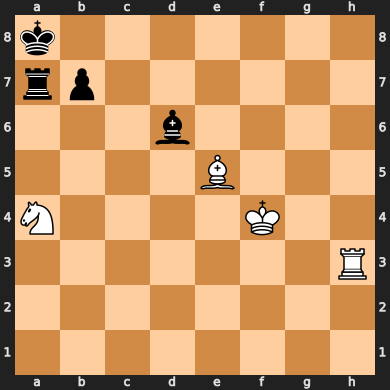

In [42]:
board2 = chess.Board()
chess.Board.clear(board2)
chess.Board.set_piece_at(board2, chess.F4, chess.Piece.from_symbol('K'))
chess.Board.set_piece_at(board2, chess.A8, chess.Piece.from_symbol('k'))

chess.Board.set_piece_at(board2, chess.A4, chess.Piece.from_symbol('N'))
chess.Board.set_piece_at(board2, chess.E5, chess.Piece.from_symbol('B'))
chess.Board.set_piece_at(board2, chess.H3, chess.Piece.from_symbol('R'))



chess.Board.set_piece_at(board2, chess.A7, chess.Piece.from_symbol('r'))
chess.Board.set_piece_at(board2, chess.B7, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board2, chess.D6, chess.Piece.from_symbol('b'))


board2





In [17]:
play_game(compMove, random_player, board2)

checkmate: White wins!


(True, 'checkmate: White wins!', Board('1k6/rp6/1N1B4/8/5K2/7R/8/8 b - - 0 2'))

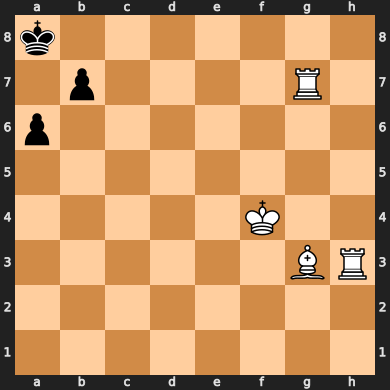

In [43]:
board3 = chess.Board()
chess.Board.clear(board3)
chess.Board.set_piece_at(board3, chess.F4, chess.Piece.from_symbol('K'))
chess.Board.set_piece_at(board3, chess.A8, chess.Piece.from_symbol('k'))



chess.Board.set_piece_at(board3, chess.H3, chess.Piece.from_symbol('R'))
chess.Board.set_piece_at(board3, chess.G3, chess.Piece.from_symbol('B'))
chess.Board.set_piece_at(board3, chess.G7, chess.Piece.from_symbol('R'))



chess.Board.set_piece_at(board3, chess.A6, chess.Piece.from_symbol('p'))
chess.Board.set_piece_at(board3, chess.B7, chess.Piece.from_symbol('p'))



board3




In [44]:
play_game(compMove, random_player, board3)

(None, 'Game interrupted!', Board('6R1/8/1k6/pp6/5K2/6BR/8/8 w - - 6 8'))

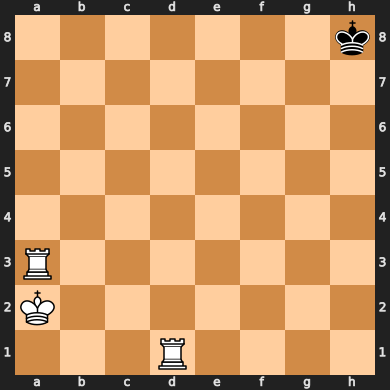

In [20]:
board4 = chess.Board()
chess.Board.clear(board4)
chess.Board.set_piece_at(board4, chess.H8, chess.Piece.from_symbol('k'))
chess.Board.set_piece_at(board4, chess.A2, chess.Piece.from_symbol('K'))


chess.Board.set_piece_at(board4, chess.A3, chess.Piece.from_symbol('R'))
chess.Board.set_piece_at(board4, chess.D1,chess.Piece.from_symbol('R'))


board4

In [21]:
play_game(compMove, random_player, board4)

draw: stalemate


(None, 'draw: stalemate', Board('7k/R7/8/8/8/8/K7/6R1 b - - 5 3'))

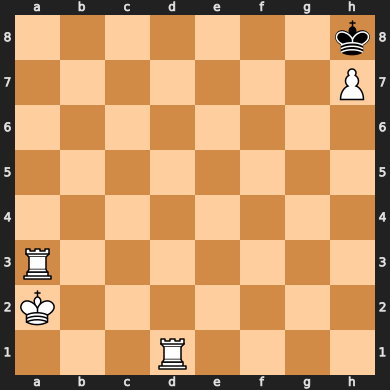

In [27]:
board5 = chess.Board()
chess.Board.clear(board5)
chess.Board.set_piece_at(board5, chess.H8, chess.Piece.from_symbol('k'))
chess.Board.set_piece_at(board5, chess.A2, chess.Piece.from_symbol('K'))


chess.Board.set_piece_at(board5, chess.A3, chess.Piece.from_symbol('R'))
chess.Board.set_piece_at(board5, chess.D1,chess.Piece.from_symbol('R'))
chess.Board.set_piece_at(board5, chess.H7,chess.Piece.from_symbol('P'))


board5

In [28]:
play_game(compMove, random_player, board5)

draw: stalemate


(None, 'draw: stalemate', Board('7k/R6P/8/8/8/8/K7/3R4 b - - 1 1'))